In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os

In [2]:
input_path = '/Volumes/Behaviour/Tailored 3sec 2P Trials' 
output_path = '/Volumes/Behaviour/Tailored 3sec 2P Trials/Trial Mean Correlation Matrices'
# Import Pearsons R between neuron activity and behaviour computed with "Correlate cell activity to motion energy"
pearsons = pd.read_csv('/Volumes/Behaviour 3/Bodyvectors_07_2000/pearsons_long_07_2000.csv', index_col=0)
sessions = [session for session in os.listdir(input_path) if session.endswith('.csv')]
stimuli = ['warm', 'hot', 'opto', 'off-target', 'von frey', 'pin-prick', 'approach', 'no stim']


processing:  dF_F0_3sec_2P06_Ses01.csv


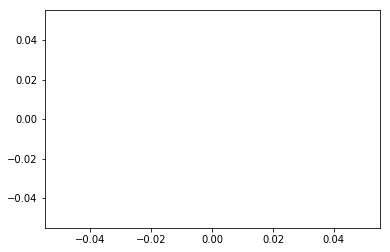

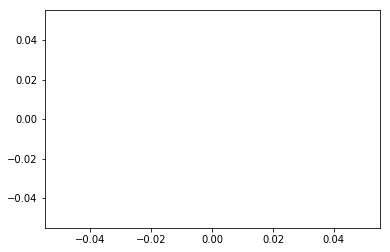

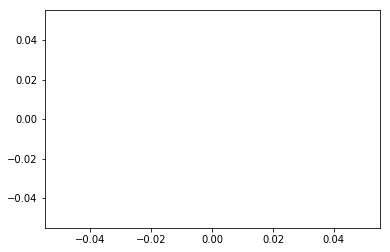

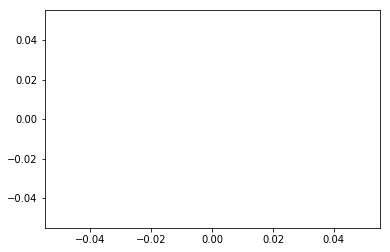

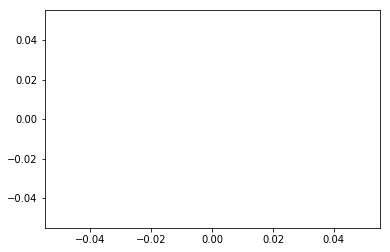

...

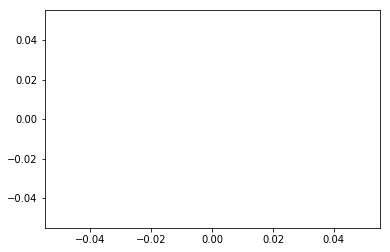

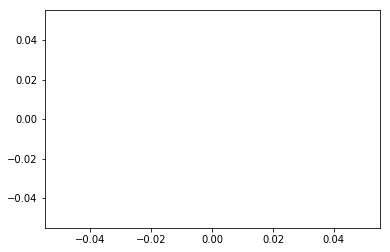

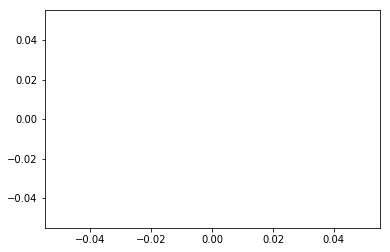

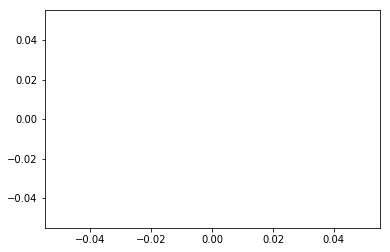

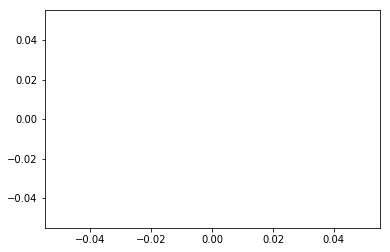

KeyboardInterrupt: 

In [3]:
#max_matrix = pd.DataFrame()

for session in sessions:
    if session.startswith('._'): # circumventing issues with invisible files on external drives
        continue
    if session.endswith('2P05_Ses01.csv'): # excluding for the time being incomplete sessions (half-sessions)
        continue
    if session.endswith('2P05_Ses02.csv'):
        continue
    if session.endswith('2P07_Ses02.csv'):
        continue
    if session.endswith('2P11_Ses03.csv'):
        continue
    if session.endswith('2P08_Ses03.csv'): # this one doesn't have 'opto' or 'approach'
        continue
    if session.endswith('CFA.csv'): # excluding for the time being CFA sessions
        continue
    
    print('processing: ', session)
    
    session_name = session[11:21]
    
    # Find "still cells" = Pearsons R <0.2 (neurons that show low correlation to motion)
    session_pearsons = pearsons[pearsons['cell_id'].str.contains(str(session_name))]
    motion = session_pearsons[session_pearsons['pearsons'] >= 0.20]
    motion_ids = list(motion['cell_id'])
    
    cells = pd.read_csv(os.path.join(input_path,session), index_col=0)
    still_cells = cells.drop(columns=motion_ids)
    still_ids = list(still_cells.columns)
    
    #mean_matrix = pd.DataFrame()
    #df1 = pd.DataFrame()
    
    for s in stimuli:
        cols = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19]
        trial_means = []
        trial_maxis = []
        stimulation = still_cells[still_cells['identifier'].str.contains(str((s)))]
        stimulation = stimulation.reset_index(drop=True)
        trials = stimulation['identifier'].unique()
        
        for sid in still_ids[:-1]:
            repli_traces = pd.DataFrame()
            
            for t in trials:
                trace_idx = stimulation[stimulation['identifier'].str.contains(str(t))].index.tolist()
                trace = stimulation[sid]
                temp_trace = trace.loc[trace_idx[0]:trace_idx[-1]]
                temp_trace = temp_trace.reset_index(drop=True)
                repli_traces[t] = temp_trace
                smooth_trace = temp_trace.rolling(2, center=True).mean()
                plt.plot(smooth_trace, alpha=0.5)
                plt.axvline(x=10, color='red', lw=1)
                plt.ylim([-0.02,0.1])
                plt.title(s+'_'+sid)
            plt.plot(repli_traces.mean(axis=1), color='black', alpha=0.5)
            plt.show()
            
            #trial_means.append(repli_traces.mean(axis=1))
            #trial_maxis.append(repli_traces.max(axis=0).mean())
            
        #df = pd.DataFrame(trial_means, columns=cols)
        #df1[s] = trial_maxis
        #mean_matrix = pd.concat([mean_matrix, df], axis=1)
        
    #df1['cell'] = still_ids[:-1]
    #max_matrix = pd.concat([max_matrix, df1], axis=0)

        
    #plt.figure(figsize=(10,20))
    #plt.imshow(mean_matrix, vmin=-0.02, vmax=0.1)
    #plt.colorbar()
    #plt.title(session_name)
    #plt.xticks([10,30,50,70,90,110,130,150], stimuli, rotation=20)
    #plt.ylabel('cell #')
    #plt.savefig(os.path.join(output_path, session_name +'_heatmap_3sec.png'))
    #plt.show()

#max_matrix = max_matrix.set_index('cell')
    
    

In [12]:
max_matrix.to_csv(os.path.join(output_path, 'max_matrix.csv'))

In [42]:

print(max_matrix.shape)
max_matrix.head()

(14836, 8)


,warm,hot,opto,off-target,von frey,pin-prick,approach,no stim
cell,,,,,,,,
2P06_Ses01_0,0.036767,0.025299,0.050288,0.025478,0.038166,0.031724,0.036849,0.056930
2P06_Ses01_1,0.035793,0.033005,0.037835,0.029860,0.028189,0.043915,0.037625,0.036636
2P06_Ses01_2,0.018163,0.018637,0.026148,0.046207,0.022214,0.032198,0.031614,0.017475
2P06_Ses01_3,0.033599,0.029483,0.044968,0.033991,0.015485,0.021507,0.036125,0.018033
2P06_Ses01_4,0.064329,0.015311,0.017545,0.011723,0.014700,0.012454,0.034400,0.039726


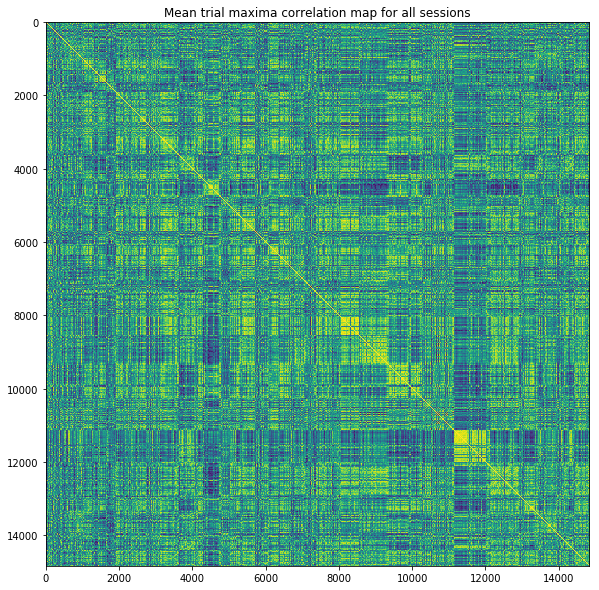

In [43]:
corr = max_matrix.T.corr().values
plt.figure(figsize = (10,10))
plt.imshow(corr)
plt.title("Mean trial maxima correlation map for all sessions")
plt.show()



In [44]:
import fastcluster

clustered = fastcluster.linkage(max_matrix, method='ward', metric='euclidean', preserve_input=True)


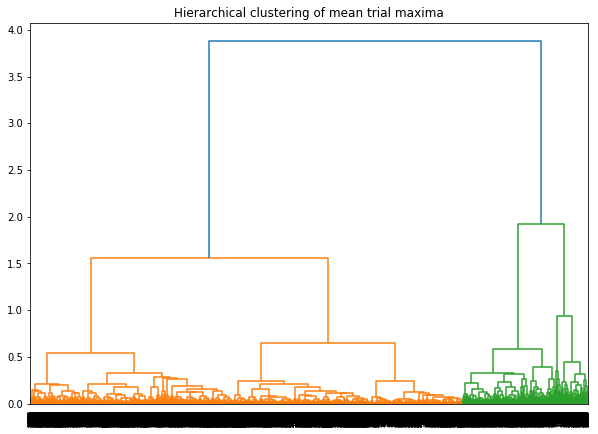

In [45]:
plt.figure(figsize=(10, 7))
dend = shc.dendrogram(clustered)
plt.title("Hierarchical clustering of mean trial maxima")
plt.show()



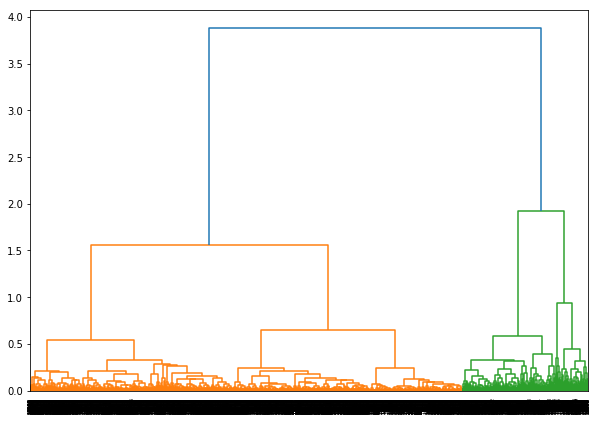

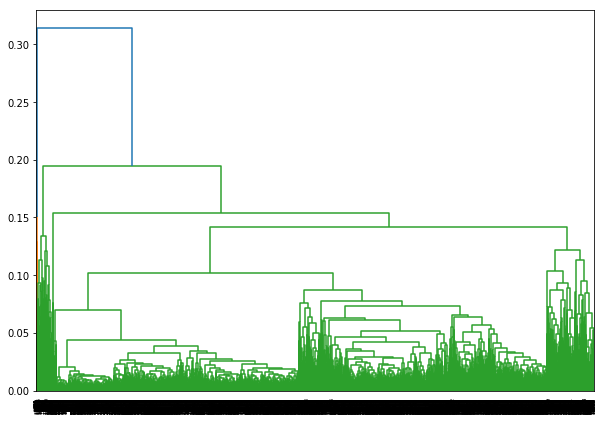

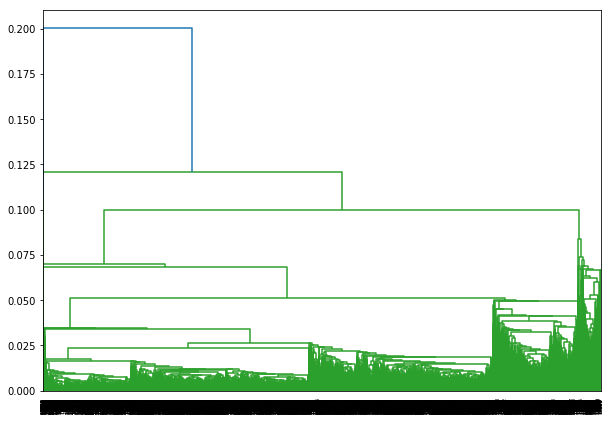

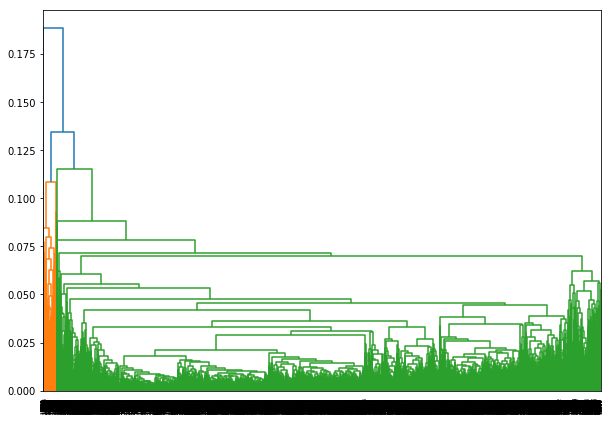

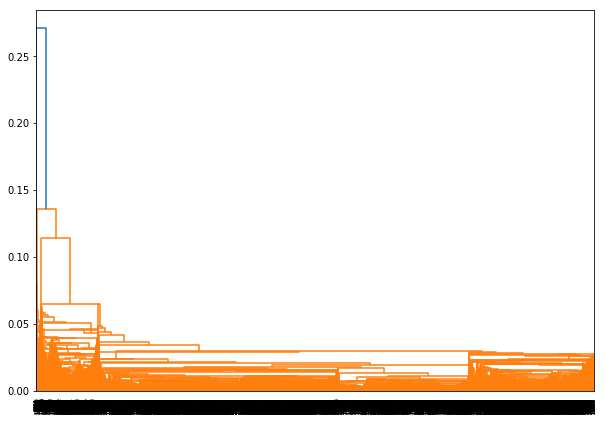

In [35]:
import scipy.cluster.hierarchy as shc

plt.figure(figsize=(10, 7))
dend = shc.dendrogram(shc.linkage(max_matrix, method='ward'))
plt.show()

from sklearn.cluster import AgglomerativeClustering

cluster = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
cfit = cluster.fit_predict(max_matrix)

pd.DataFrame(cfit).to_csv(output_path+"/cfit.csv")







In [36]:
from sklearn.cluster import AgglomerativeClustering

cluster = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
cfit = cluster.fit_predict(max_matrix)

pd.DataFrame(cfit).to_csv(output_path+"/cfit.csv")



/Users/aspra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:35: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).eps,
/Users/aspra/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:597: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).eps, copy_X=Tr

2P11_Ses03


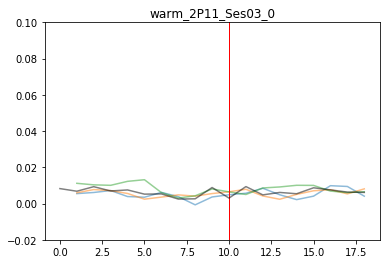

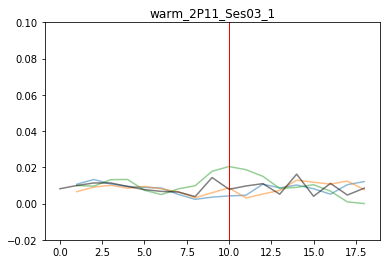

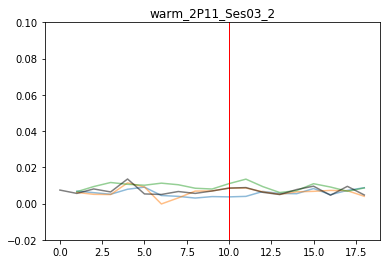

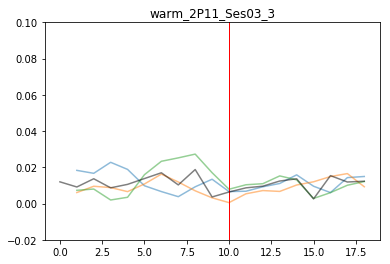

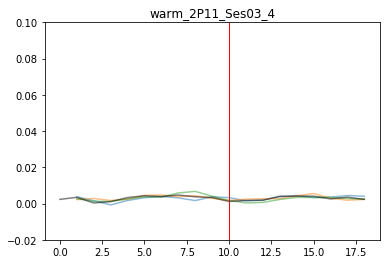

...

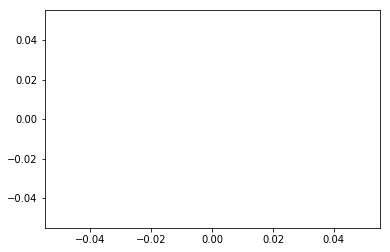

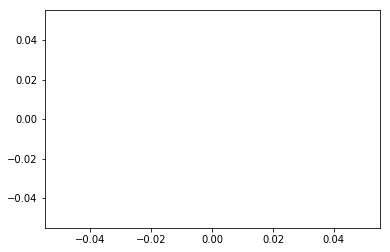

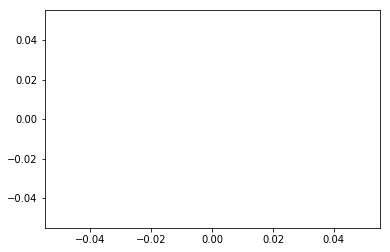

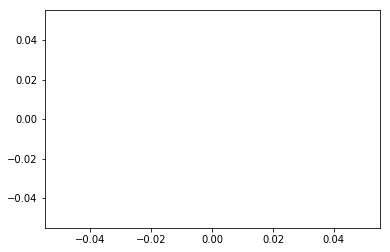

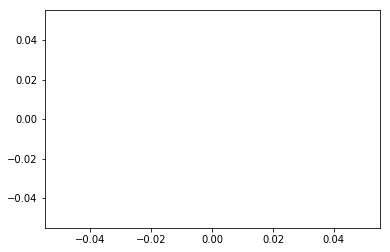

KeyboardInterrupt: 

In [24]:
session = 'dF_F0_SHORT_2P11_Ses03.csv'
session_name = session[12:22]
print(session_name)
    
session_pearsons = pearsons[pearsons['cell_id'].str.contains(str(session_name))]
motion = session_pearsons[session_pearsons['pearsons'] >= 0.20]
motion_ids = list(motion['cell_id'])
    
cells = pd.read_csv(os.path.join(input_path,session), index_col=0)
still_cells = cells.drop(columns=motion_ids)
still_ids = list(still_cells.columns)
    
#heat_matrix = pd.DataFrame()
df1 = pd.DataFrame()

for s in stimuli:
    cols = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19]
    trial_means = []
    trial_maxis = []
    stimulation = still_cells[still_cells['identifier'].str.contains(str((s)))]
    stimulation = stimulation.reset_index(drop=True)
    trials = stimulation['identifier'].unique()
        
    for sid in still_ids[:-1]:
        repli_traces = pd.DataFrame()
            
        for t in trials:
            trace_idx = stimulation[stimulation['identifier'].str.contains(str(t))].index.tolist()
            trace = stimulation[sid]
            temp_trace = trace.loc[trace_idx[0]:trace_idx[-1]]
            temp_trace = temp_trace.reset_index(drop=True)
            repli_traces[t] = temp_trace
            smooth_trace = temp_trace.rolling(2, center=True).mean()
            plt.plot(smooth_trace, alpha=0.5)
            plt.axvline(x=10, color='red', lw=1)
            plt.ylim([-0.02,0.1])
            plt.title(s+'_'+sid)
        plt.plot(repli_traces.mean(axis=1), color='black', alpha=0.5)
        plt.show()
            
         #trial_means.append(repli_traces.mean(axis=1))
         #trial_maxis.append(repli_traces.max(axis=0).mean())
            
     #df = pd.DataFrame(trial_means, columns=cols)
     #df1[s] = trial_maxis
     #heat_matrix = pd.concat([heat_matrix, df], axis=1)

 #df1['cell'] = still_ids[:-1]
     
    

In [18]:
len(trace)/19


3.0

In [19]:
temp_trace

0     0.003132
1     0.002407
2     0.001425
3     0.001122
4     0.002061
5     0.001402
6     0.004223
7     0.002507
8     0.004740
9     0.003010
10    0.004294
11    0.001700
12    0.004553
13    0.001070
14    0.002360
15    0.000131
16    0.003900
17   -0.000005
18    0.003164
Name: 2P06_Ses02_1154, dtype: float64

In [167]:
df1

,warm,hot,opto,off-target,von frey,pin-prick,approach,no stim,cell
0,0.010405,0.008486,0.009449,0.009344,0.009093,0.010165,0.008624,0.007821,2P09_Ses05_0
1,0.019288,0.021320,0.031581,0.015026,0.043012,0.034824,0.020197,0.015753,2P09_Ses05_2
2,0.014372,0.014009,0.018936,0.014013,0.030026,0.016043,0.012979,0.011892,2P09_Ses05_3
3,0.036858,0.029152,0.050484,0.031699,0.058435,0.032728,0.036357,0.022474,2P09_Ses05_4
4,0.016217,0.016033,0.016779,0.011977,0.029871,0.021883,0.010462,0.011004,2P09_Ses05_8
...,...,...,...,...,...,...,...,...,...
475,0.007785,0.008869,0.007581,0.006854,0.008363,0.010870,0.005798,0.005815,2P09_Ses05_1353
476,0.011068,0.010399,0.010521,0.009070,0.009753,0.011877,0.009446,0.007998,2P09_Ses05_1364
477,0.014421,0.011434,0.010095,0.009429,0.010705,0.014458,0.009363,0.008331,2P09_Ses05_1367
478,0.018440,0.015199,0.014389,0.010960,0.016019,0.017971,0.010054,0.009183,2P09_Ses05_1370


In [165]:
len(still_ids)

481

In [125]:
sessions = 'dF_F0_3sec_2P11_Ses01.csv'
s = 'warm'

In [159]:
cols = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19]
trial_means = []
df1 = pd.DataFrame()
stimulation = still_cells[still_cells['identifier'].str.contains(str((s)))]
stimulation = stimulation.reset_index(drop=True)
trials = stimulation['identifier'].unique()

trial_maxis = []

for sid in still_ids[:-1]:
    repli_traces = pd.DataFrame()
    
    for t in trials:
        trace_idx = stimulation[stimulation['identifier'].str.contains(str(t))].index.tolist()
        trace = stimulation[sid]
        temp_trace = trace.loc[trace_idx[0]:trace_idx[-1]]
        temp_trace = temp_trace.reset_index(drop=True)
        repli_traces[t] = temp_trace
        
        #smooth_trace = temp_trace.rolling(2, center=True).mean()
        #plt.plot(smooth_trace, alpha=0.5)
        #plt.axvline(x=10, color='red', lw=1)
        #plt.ylim([-0.02,0.1])
        #plt.title(s+'_'+sid)
    #plt.plot(repli_traces.mean(axis=1), color='black', alpha=0.5)
    #plt.show()
          
    trial_means.append(repli_traces.mean(axis=1))
    #trial_mean_max = repli_traces.max(axis=0).mean()
    trial_maxis.append(repli_traces.max(axis=0).mean())
    
df = pd.DataFrame(trial_means, columns=cols)
df1[s] = trial_maxis

In [156]:
len(trial_maxis)

455